[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/a-parida12/RNN_Trials/blob/main/IntroRNNs_LSTM.ipynb)


# Vehicle Management System

We have a lot of applications where we need to identify the moving vehicles in a region. They can be used for 


1.   Traffic Mangement Systems
2.   No StopGo Toll Taxes
3.   Driver Fault Detection

This not an exhaustive list, the sky is actually the limit. What are some applications you can think of using vehicle video surveillance?


## What is a Video?

As we already know that video is nothing but a collection of images. In general there are x frames(images) and that are diplayed within a second.

In [ ]:
# Let us try and see some of the frames
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
import imageio


gif_traffic = cv2.VideoCapture('/content/traffic_video.gif')

In [ ]:
def extract_frames_from_video(video :cv2.VideoCapture)->list:
  list_frames = []
  while True:
    success, image = video.read()
    if success == True:
      image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      list_frames.append(image_rgb)
    else:
      break
  return list_frames

# Basic Attributes of the Video

This section is about loading an video and exploring its various attributes.

These include-

- Extract all frames
- Display some frames
- Identify the properties of the frames
- See the image matrix


In [ ]:
frames = extract_frames_from_video(gif_traffic)
# no of frames
len(frames)

150

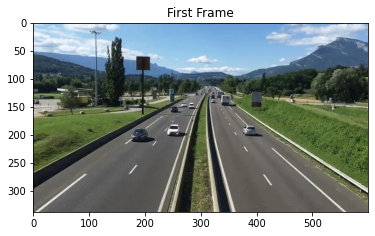

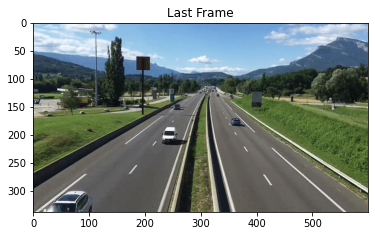

In [ ]:
# lets see the first and last frames

first_frame = frames[0]
last_frame = frames[-1]
plt.title("First Frame")
plt.imshow(first_frame)
plt.show()
plt.title("Last Frame")
plt.imshow(last_frame)
plt.show()

In [ ]:
# lets look an image
first_frame.shape


(338, 600, 3)

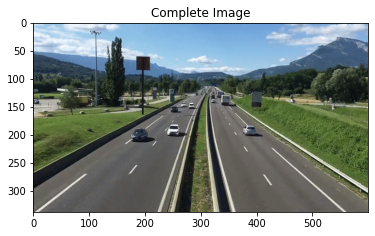

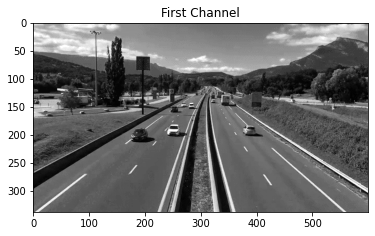

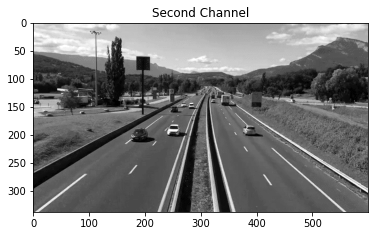

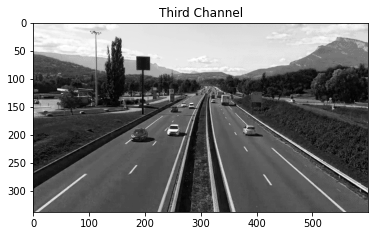

In [ ]:
# how does each of the channel look?
plt.title("Complete Image")
plt.imshow(first_frame)
plt.show()
plt.title("First Channel")
plt.imshow(first_frame[...,0], cmap='Reds')
plt.show()
plt.title("Second Channel")
plt.imshow(first_frame[...,1], cmap='Greens')
plt.show()
plt.title("Third Channel")
plt.imshow(first_frame[...,2], cmap='Blues')
plt.show()

In [ ]:
first_frame[...,1]

array([[234, 234, 249, ..., 158, 168, 165],
       [224, 234, 239, ..., 168, 168, 168],
       [214, 224, 224, ..., 168, 168, 168],
       ...,
       [102, 102, 107, ...,  99, 111,  99],
       [103, 107,  95, ...,  99, 105,  99],
       [ 97,  97,  87, ...,  99,  99, 111]], dtype=uint8)

# Image Processing

We will follow along a task to identify vehicles in the video and segment them.

We will combine simple processes like-

- Color to GrayScale
- Image Binarisation
- Connected Component Labeling




In [ ]:
# Convert the frames to GrayScale
gray_frames = []

for frame in frames:
  gray_frame = (frame[...,0]/3+ frame[...,1]/3 +frame[...,2]/3)
  gray_frames.append(gray_frame)

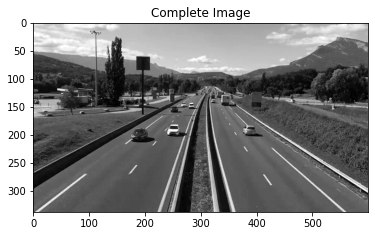

In [ ]:
plt.title("Complete Image")
plt.imshow(gray_frames[0], cmap ='gray')
plt.show()

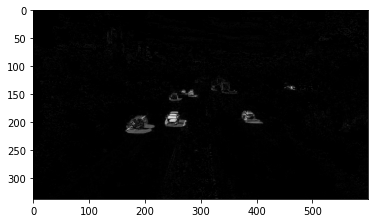

In [ ]:
# Image Substraction
moved_frame = np.abs(gray_frames[1]-gray_frames[0])
plt.imshow(moved_frame, cmap='gray')
plt.show()

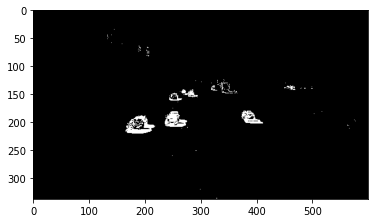

In [ ]:
# Image Binarisation
binarized_frame = np.zeros_like(moved_frame)
binarized_frame[moved_frame>30] =1 
plt.imshow(binarized_frame, cmap='gray')
plt.show()

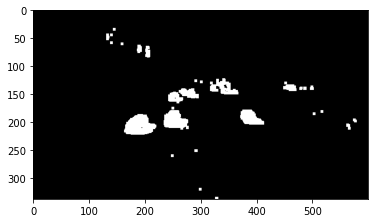

In [ ]:
# Dilation
kernel = np.ones((5,5), np.uint8)
dilated_frame = cv2.dilate(binarized_frame, kernel, iterations=1)
plt.imshow(dilated_frame, cmap='gray')
plt.show()


In [ ]:
# Connected Component Labeling
numLabels, labels, stats, centroids = cv2.connectedComponentsWithStats(np.uint8(dilated_frame), 2, cv2.CV_8U)

for i in range(1, numLabels):
  # extract the connected component statistics for the current
  # label
  area = stats[i, cv2.CC_STAT_AREA]
  # Remove small objects(small car or noise)
  if area <200:
    labels[labels==i]=0 


labels[labels>0]=1 


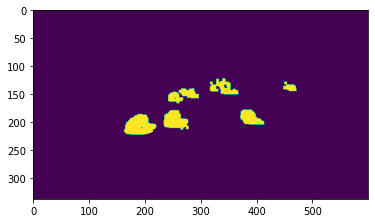

In [ ]:
plt.imshow(labels)
plt.show()

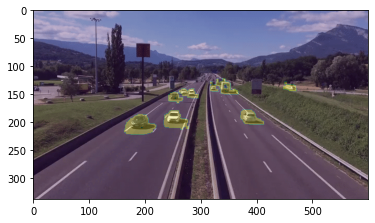

In [ ]:
plt.imshow(first_frame)
plt.imshow(labels, alpha =0.3)
plt.show()

In [ ]:
def cc_analysis(frame):
  numLabels, labels, stats, _ = cv2.connectedComponentsWithStats(np.uint8(frame), 2, cv2.CV_8U)
  zero_c = np.zeros_like(labels)
  for i in range(1, numLabels):
    # extract the connected component statistics for the current
    # label
    area = stats[i, cv2.CC_STAT_AREA]
    # Remove small objects(small car or noise)
    if area <200 or area>20000:
      labels[labels==i]=0 
  labels[labels>0]=255
  mask = np.stack([zero_c, zero_c, labels], axis=-1) 
  return mask

def color_to_gray(frame):
  return (frame[...,0]/3+ frame[...,1]/3 +frame[...,2]/3)

def identify_vehicles(video :cv2.VideoCapture):
  final_frames = []
  kernel = np.ones((5,5), np.uint8)
  list_frames = extract_frames_from_video(video)

  for i in range(len(list_frames)):
    current_frame = color_to_gray(list_frames[i])
    next_frame = color_to_gray(list_frames[min(i+1,len(list_frames)-1)])

    diff_frame = np.abs(current_frame-next_frame)
    
    bin_frame = np.zeros_like(diff_frame)
    # binarisation by thresholding
    bin_frame[diff_frame>50] =1

    # connected component analysis to identify cars
    dil_frame = cv2.dilate(bin_frame, kernel, iterations=1)
    car_frame = cc_analysis(dil_frame)
    
    dst = cv2.add(np.uint8(list_frames[i]), np.uint8(car_frame))
    final_frames.append(dst)
  return final_frames
  


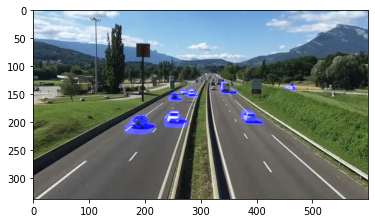

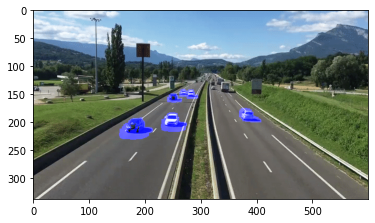

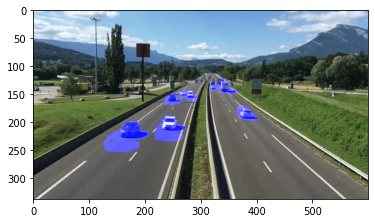

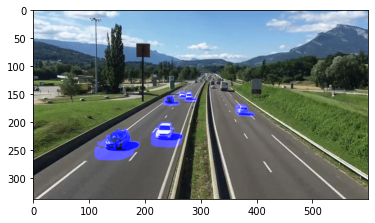

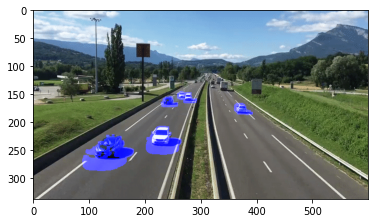

...

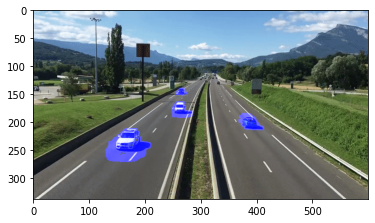

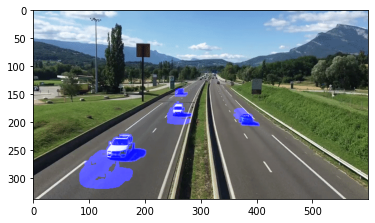

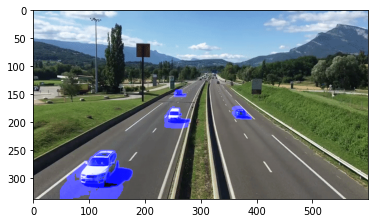

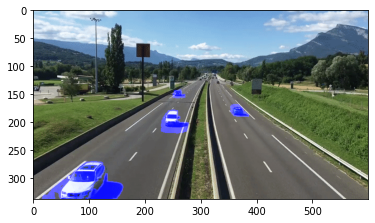

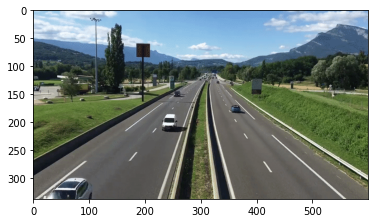

In [ ]:
gif_traffic = cv2.VideoCapture('/content/traffic_video.gif')
image_lst= identify_vehicles(gif_traffic)
imageio.mimsave('/content/annotated_vehicle.gif', image_lst, fps=50)

# Homework

Try extending the code to estimate the numbers of vehicles that are entering or exiting a region. This can be used for a toll managment system.


Bonus Points: If you can identify the motorcycle, cars and trucks separately.


Hint: Think of the size of the blobs.



In [ ]:
## Your code here

# Project

## Problem
### Identification of unruly drivers.

Traffic Police of smart city Bhubaneswar is overburden with the number of unruly drivers on its roads. It has installed a number of traffic cams to identify and catch traffic violation offenders. It has hired a group of smart data scientist(you) to come up with a solution to help them automate the task. Can you help them identify the unruly drivers? 

Who is an unruly driver on the highways?

- the one who changes lanes unneccesarily
- the one drives on the wrong side of the road
- the one who breaks speed limit

## Task

- highlight all unruly drivers in red segmentation
- highlight all good drivers in green segmentation
- when a good driver turns bad the color should change from green to red and vice versa.

## Bonus Point

If you can extract the numberplate information of the unruly drivers